In [ ]:
# From:
# © MIT 6.S191: Introduction to Deep Learning

# 2. Generación de Música con RNNs

Se creara una red neuronal recurrente (RNN) que genere música. Se entrenará con un set de datos con patrones de canciones. Los datos de entrada serán notas en notación ABC. Por último se usará el modelo entrenado para generar nueva música.

## 2.1 Dependencias

In [ ]:
# Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf

# MIT 6.S191 package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Otras Librerías
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1


assert len(tf.config.list_physical_devices('GPU')) > 0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## 2.2 Dataset

![Let's Dance!](http://33.media.tumblr.com/3d223954ad0a77f4e98a7b87136aa395/tumblr_nlct5lFVbF1qhu7oio1_500.gif)

El set de datos contiene miles de canciones de folk Irlandesas representadas con la notación ABC.


In [ ]:
import codecs
entrada=codecs.open("input.txt","r",encoding="utf-8")

# Descarga del Dataset
#songs = mdl.lab1.load_training_data()
songs=entrada.read().split("\r\n\r\n\r\n")

# Ejemplo de datos
example_song = songs[0]
print("\n Canción Ejemplo: ")
print(example_song)


 Canción Ejemplo: 
X: 1
T: The Enchanted Valley
M: 2/4
L: 1/16
B: "O'Neill's 1"
N: "Very slow" "collected by J. O'Neill"
N:
Z: "Transcribed by Norbert Paap, norbertp@bdu.uva.nl"
Z:
K:Gm
G3-A (Bcd=e) | f4 (g2dB) | ({d}c3-B) G2-E2 | F4 (D2=E^F) |
G3-A (Bcd=e) | f4 d2-f2 | (g2a2 b2).g2 | {b}(a2g2 f2).d2 |
(d2{ed}c2) B2B2 | (A2G2 {AG}F2).D2 | (GABc) (d2{ed}c>A) | G2G2 G2z ||
G | B2c2 (dcAB) | G2G2 G3G | B2d2 (gfdc) | d2g2 (g3ga) |
(bagf) (gd)d>c | (B2AG) F-D.D2 | (GABc) d2d2 | (bgfd) cA.F2 |
G2A2 (B2{cB}AG) | A3-G F2-D2 | (GABc) (d2{ed}c>A) | G2G2 G2z2 ||


Si transformamos la notación a audio:

In [ ]:
mdl.lab1.play_song(example_song)

Meta datos de las canciones

In [ ]:
songs_joined = "\n\n".join(songs)

vocab = sorted(set(songs_joined))
print("Existen ", len(vocab), "caracteres únicos en el set de datos")

Existen  96 caracteres únicos en el set de datos


## 2.3 Pre-procesamiento del Set de Datos

El objetivo es entrenar el modelo LSTM para aprender patrones de música con notación ABC. La idea es que prediga una nueva canción con la información que tiene.  
A bajo nivel, lo que tendría que hacer es que dado un caracter o una secuencia de caracteres, siga generando caracteres según lo aprendido. Por lo tanto, tendríamos que entrenarlo con las secuencias de caracteres de las canciones del set de datos y usar como etiqueta la salida de la canción en $t+1$.

### Mapeo de texto a números

In [ ]:
# caracter a indice
#   ejemplo: `char2idx["d"]`.
char2idx = {u:i for i, u in enumerate(vocab)}

# indice a caracter
#   ejemplo: `idx2char[0]`.
idx2char = np.array(vocab)

In [ ]:
print('{')
for char,_ in zip(char2idx, range(83)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\t':   0,
  '\n':   1,
  '\r':   2,
  ' ' :   3,
  '!' :   4,
  '"' :   5,
  '#' :   6,
  '%' :   7,
  '&' :   8,
  "'" :   9,
  '(' :  10,
  ')' :  11,
  '*' :  12,
  '+' :  13,
  ',' :  14,
  '-' :  15,
  '.' :  16,
  '/' :  17,
  '0' :  18,
  '1' :  19,
  '2' :  20,
  '3' :  21,
  '4' :  22,
  '5' :  23,
  '6' :  24,
  '7' :  25,
  '8' :  26,
  '9' :  27,
  ':' :  28,
  ';' :  29,
  '<' :  30,
  '=' :  31,
  '>' :  32,
  '?' :  33,
  '@' :  34,
  'A' :  35,
  'B' :  36,
  'C' :  37,
  'D' :  38,
  'E' :  39,
  'F' :  40,
  'G' :  41,
  'H' :  42,
  'I' :  43,
  'J' :  44,
  'K' :  45,
  'L' :  46,
  'M' :  47,
  'N' :  48,
  'O' :  49,
  'P' :  50,
  'Q' :  51,
  'R' :  52,
  'S' :  53,
  'T' :  54,
  'U' :  55,
  'V' :  56,
  'W' :  57,
  'X' :  58,
  'Y' :  59,
  'Z' :  60,
  '[' :  61,
  '\\':  62,
  ']' :  63,
  '^' :  64,
  '_' :  65,
  'a' :  66,
  'b' :  67,
  'c' :  68,
  'd' :  69,
  'e' :  70,
  'f' :  71,
  'g' :  72,
  'h' :  73,
  'i' :  74,
  'j' :  75,
  'k' :  7

In [ ]:
### Vectorizar las canciones ###

'''TODO: Escribir una función que convierta la cadena de texto de las canciones
    a una representación numérica.
    Salida: np.array con N elementos (numero de caracteres en la cadena de entrada)
'''

def vectorize_string(string):
  # TODO
  vectorized_list = np.array([char2idx[s] for s in string])
  return vectorized_list


vectorized_songs = vectorize_string(songs_joined)

In [ ]:
print ('{} ---- caracteres a números enteros ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))

assert isinstance(vectorized_songs, np.ndarray), "el formato de la salida no es correcto"

'X: 1\r\nT: T' ---- caracteres a números enteros ----> [58 28  3 19  2  1 54 28  3 54]


### Dividir el dataset en entrenamiento y etiquetas

Como en el ejercicio anterior, la secuencia será de largo `seq_lenth` tanto la de entrenamiento como la de eqtiquetas. La diferencia entre una y otra será que la secuencia de etiquetas estará desplazada una posición a la derecha respecto a la secuencia de entrenamiento.  

El largo de la secuencia se definirá con `batch_size` y se tomará aleatoriamente desde dónde se comienza la secuencia. Se generarán múltiples "batches" de este tipo para el entrenamiento.

In [ ]:

def get_batch(vectorized_songs, seq_length, batch_size):
  # Largo total del set de entrenamiento
  n = vectorized_songs.shape[0] - 1
  # Aleatoriamente se inicia en alguna posicion
  # del total de la secuencia
  idx = np.random.choice(n-seq_length, batch_size)

  '''TODO: implementar la lista de entrenamiento'''
  #input_batch = # TODO
  input_batch = [vectorized_songs[i:i+seq_length] for i in idx]
  '''TODO: implementar la lista de salida o etiquetas'''
  #output_batch = # TODO
  output_batch = [vectorized_songs[i+1: i+1+seq_length] for i in idx]

  # Reshape para tener las dimensiones necesarias para el modelo
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch


# Test de función implementada
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args):
   print("======\n[FAIL]")
else:
   print("======\n[PASS]")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS]


## 2.4 Modelo RNN con LSTM

EL modelo está basado en la arquitectura LSTM, donde se usa un vector de estado para mantener información sobre las relaciones temporales entre caracteres consecutivos. La salida de la neurona LSTM se conecta a una capa de neuronas totalmente conectadas [`Dense`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense) cuya salida será la probabilidad de que cada caracter del vocabulario sea el siguiente.

El modelo tendrá 3 etapas:

* [`tf.keras.layers.Embedding`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Embedding): Capa de entrada que mapea los números de entrada a un vector de características.
* [`tf.keras.layers.LSTM`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/LSTM): LSTM con `units=rnn_units`.
* [`tf.keras.layers.Dense`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense): Capa de salida con `vocab_size` salidas.


<img src="https://raw.githubusercontent.com/aamini/introtodeeplearning/2019/lab1/img/lstm_unrolled-01-01.png" alt="Drawing"/>

### Definición del modelo

In [ ]:
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
    rnn_units,
    return_sequences=True,
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [ ]:
'''TODO: Agregar la etapa de LSTM, Dense.'''
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Etapa 1: Embeddings
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Etapa 2: LSTM
    # TODO: Llamar a la función LSTM definida anteriormente o definir la LSTM
    #LSTM('''TODO'''),
    LSTM(rnn_units),

    # Etapa 3: Capa de salida totalmente conectada para transformar
    # la salida de la LSTM a tamaño del vocabulario
    tf.keras.layers.Dense(units=vocab_size)
    #'''TODO: Capa Densa'''
  ])

  return model

model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [ ]:
model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_7 (Embedding)     (32, None, 256)           24576     
                                                                 
 lstm_7 (LSTM)               (32, None, 1024)          5246976   
                                                                 
 dense_7 (Dense)             (32, None, 96)            98400     
                                                                 
Total params: 5,369,952
Trainable params: 5,369,952
Non-trainable params: 0
_________________________________________________________________


In [ ]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 96) # (batch_size, sequence_length, vocab_size)


## 2.5 Entrenamiento

In [ ]:
'''TODO: Definir la función de costo para calcular la diferencia entre el resultado
    y las etiquetas '''
def compute_loss(labels, logits):
  #loss = tf.keras.losses.sparse_categorical_crossentropy('''TODO''', '''TODO''', from_logits=True) # TODO
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

'''TODO: Calcular la pérdida entre la salida obtenida y la etiqueta en
    la prueba anterior'''
#example_batch_loss = compute_loss('''TODO''', '''TODO''') # TODO
example_batch_loss = compute_loss(y, pred)

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)")
print("pérdida:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 96)  # (batch_size, sequence_length, vocab_size)
pérdida:       4.5634136


In [ ]:
# Parámetros de entrenamiento:
num_training_iterations = 5000  # Iteraciones
batch_size = 4  # Batch size
seq_length = 100  # Longitus de la secuencia
learning_rate = 5e-3  # Tasa de aprendizaje

# Parámetros del modelo:
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024

# Guardar checkpoint (si es muy largo el entrenamiento):
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

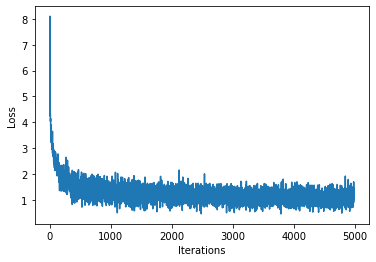

100%|██████████| 5000/5000 [02:09<00:00, 38.56it/s]


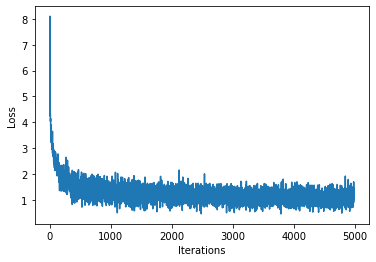

In [ ]:
### Definir el optimizador y entrenamiento ###

'''TODO: Instanciar un nuevo modelo con los parámetros de modelo que definimos'''
#model = build_model('''TODO''')
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

'''TODO: Elegir el optimizador (empezar con Adam)
  https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/ '''
#optimizer = # TODO
optimizer = tf.keras.optimizers.Adam(learning_rate)


@tf.function
def train_step(x, y):
  # Use tf.GradientTape()
  with tf.GradientTape() as tape:

    '''TODO: Generar predicción con la entrada x'''
    #y_hat = model('''TODO''')
    y_hat = model(x)

    '''TODO: calcular la pérdida con y hat e y'''
    #loss = compute_loss('''TODO''', '''TODO''')
    loss = compute_loss(y, y_hat)

  # Cálculo del gradiente para todas las variables del modelo
  grads = tape.gradient(loss, model.trainable_variables)

  # Se le pasan los gradientes al optimizador para que actualice el modelo
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

##################
# Entrenamiento  #
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear()

for iter in tqdm(range(num_training_iterations)):

  # Generar un batch
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Barra de progreso
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Guardar checkpoint
  if iter % 100 == 0:
    model.save_weights(checkpoint_prefix)

# Guardar checkpoint final
model.save_weights(checkpoint_prefix)


## 2.6 Generación de Música


### Restaurar el último checkpoint

In [ ]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_9 (Embedding)     (1, None, 256)            24576     
                                                                 
 lstm_9 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_9 (Dense)             (1, None, 96)             98400     
                                                                 
Total params: 5,369,952
Trainable params: 5,369,952
Non-trainable params: 0
_________________________________________________________________


### Procedimiento de Predicción

* Inicializar con una "cadena semilla" el modelo, además pasar el largo de la secuencia de salida.

* Usar la cadena incial para obtener la distribución del próximo caracter. Tomar el de mayor probabilidad y usarlo como entrada de la siguiente iteración.


![LSTM inference](https://raw.githubusercontent.com/aamini/introtodeeplearning/2019/lab1/img/lstm_inference.png)

In [ ]:

def generate_text(model, start_string, generation_length=1000):

  '''TODO: Convertir la cadena de entrada a números (mapear)'''
  #input_eval = ['''TODO''']
  input_eval = [char2idx[s] for s in start_string]
  input_eval = tf.expand_dims(input_eval, 0)

  # Array para guardar los datos de salida
  text_generated = []

  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      '''TODO: Evaluar las entradas y generar la predicción a los siguientes caracteres'''
      #predictions = model('''TODO''')
      predictions = model(input_eval)

      # Dimensión de batch removida
      predictions = tf.squeeze(predictions, 0)

      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy() # Toma la muestra con mayor probabilidad

      # Pasar la predicción y el estado al siguiente modelo
      input_eval = tf.expand_dims([predicted_id], 0)

      '''TODO: agregar el caracter nuevo a la secuencia'''
      #text_generated.append('''TODO''')
      text_generated.append(idx2char[predicted_id])

  return (start_string + ''.join(text_generated))

In [ ]:
generated_text = generate_text(model, start_string="asm", generation_length=1000) # TODO
# generated_text = generate_text('''TODO''', start_string="X", generation_length=1000)

100%|██████████| 1000/1000 [00:05<00:00, 169.10it/s]


### Reproducir la música generada

In [ ]:
generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs):

  waveform = mdl.lab1.play_song(song)

  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 3 songs in text
Generated song 1


Generated song 2
